# 🎥 Tech Challenge - Fase 4 - Grupo 23


Este notebook executa:
- Detecção de rostos
- Análise de emoções
- Classificação de atividades usando rótulos manuais (supervised Learning)
- Relatório automático gerado pela aplicação   `summary.txt`
- Visualizão do relatório com LLM para sumarização e resumo dos logs
- Extra: Geração de vídeo anotado com bounding boxes reais e informações por frame

1 - Instalação das bibliotecas necessárias:


In [1]:

!pip install facenet-pytorch deepface mediapipe opencv-python-headless tqdm pandas


2 - Imports and Setup


In [2]:
import cv2
import mediapipe as mp
import numpy as np
import pandas as pd
import tensorflow as tf
from facenet_pytorch import MTCNN
from deepface import DeepFace
from tqdm import tqdm
import matplotlib.pyplot as plt
from google.colab import files
from collections import defaultdict
import json


25-05-20 19:09:49 - Directory /root/.deepface has been created
25-05-20 19:09:49 - Directory /root/.deepface/weights has been created


3 - Upload dos arquivos (vídeo + CSV)

Reduzimos a qualidade do video  para acelerar análise e inferência

!ffmpeg -i "Unlocking Facial Recognition_ Diverse Activities Analysis.mp4" -vf "scale=640:360" -c:v libx264 -crf 28 -preset veryfast output_compressed.mp4

Reduzimos... resolução (por ex: de 1080p para 480p) e bitrate com ffmpeg


In [3]:

print("📤 Upload your video file:")
uploaded = files.upload()
video_path = list(uploaded.keys())[0]

print("📤 Upload your activity_labels.csv file:")
uploaded = files.upload()
labels_path = list(uploaded.keys())[0]
df_labels = pd.read_csv(labels_path)


📤 Upload your video file:


Saving output_compressed.mp4 to output_compressed.mp4
📤 Upload your activity_labels.csv file:


Saving activity_labels_v2.csv to activity_labels_v2.csv


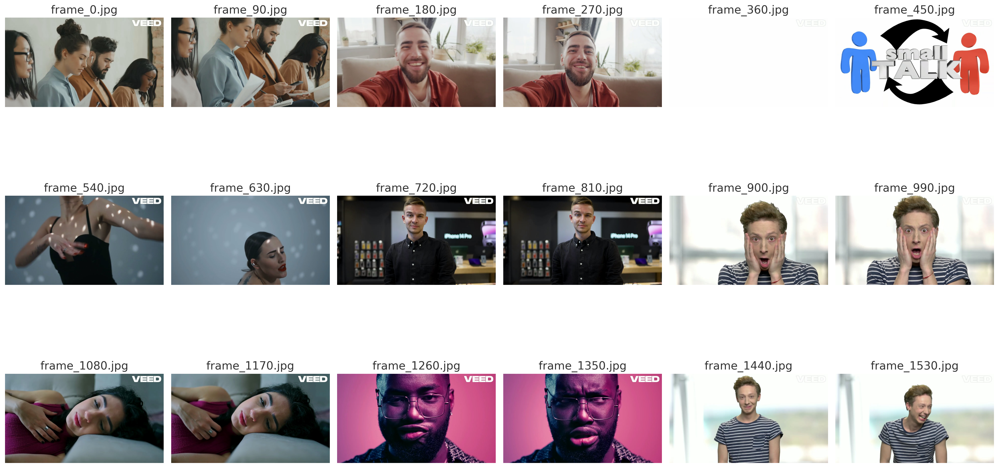


In [4]:
print(tf.config.list_physical_devices('GPU'))

[]


In [5]:

mp_pose = mp.solutions.pose
pose = mp_pose.Pose()
mtcnn = MTCNN(keep_all=True, device='cuda' if tf.config.list_physical_devices('GPU') else 'cpu')


In [6]:

cap = cv2.VideoCapture(video_path)
pose_data = []
frame_ids = []
frame_index = 0

print("🔍 Extracting pose data...")
while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break
    rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    results = pose.process(rgb)
    if results.pose_landmarks:
        landmarks = results.pose_landmarks.landmark
        keypoints = np.array([[lm.x, lm.y, lm.z] for lm in landmarks]).flatten()
        if len(keypoints) == 99:
            pose_data.append(keypoints)
            frame_ids.append(f"frame_{frame_index}")
    frame_index += 1
cap.release()


🔍 Extracting pose data...


In [7]:

df_pose = pd.DataFrame(pose_data)
df_pose['frame'] = frame_ids
df = pd.merge(df_pose, df_labels, on='frame')
X = df.drop(columns=['frame', 'activity']).values
y = pd.get_dummies(df['activity']).values
class_names = pd.get_dummies(df['activity']).columns.tolist()


In [8]:
# Confirmando o tipo de Dispositivo disponivel ...
import tensorflow as tf
print("✅ Dispositivos disponíveis:", tf.config.list_physical_devices())

✅ Dispositivos disponíveis: [PhysicalDevice(name='/physical_device:CPU:0', device_type='CPU')]


**modelo de rede neural sequencial...**

Originalemente pensamos em usar algum data set do kaggle porém como era focado no video específico da atividade não detectamos nenhum data set que tivesse a variedade de atividades no video da Platatorma...

**Por que utilizei uma rede neural densa para a classificação de imagens/vídeos?**

Porque a rede foi treinada com dados tabulados, ou seja, todas as classes possíveis foram previamente definidas e utilizadas como entrada no processo de treinamento. Essas classes foram baseadas nas ações predominantes observadas no vídeo, associadas às suas respectivas categorias, incluindo uma classe adicional de “não definido”.

O objetivo final é que o modelo consiga classificar corretamente as emoções associadas a cada ação executada nos frames.

In [9]:
print("🧠 Training activity classifier...")
model = tf.keras.Sequential([
    tf.keras.layers.Input(shape=(99,)),
    tf.keras.layers.Dense(64, activation='relu'),
    tf.keras.layers.Dense(64, activation='relu'),
    tf.keras.layers.Dense(y.shape[1], activation='softmax')
])
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model.fit(X, y, epochs=20, batch_size=8, verbose=0)
print("✅ Classifier trained.")


🧠 Training activity classifier...
✅ Classifier trained.


Execução do Modelo:

Em torno de 20 minutos com CPU!


In [10]:

# 🔄 Inferência com coordenadas reais das faces registradas no summary.txt


cap = cv2.VideoCapture(video_path)
frame_count = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))

frame_number = 0
summary_data = []
face_count = 0
anomaly_count = 0

print("🔎 Running final analysis with bounding boxes...")

while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break
    rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)

    # Inicializa dicionário do frame
    frame_record = {
        "frame": frame_number,
        "activity": "none",
        "faces": [],
        "emotions": []
    }

    # Pose classification
    results = pose.process(rgb)
    if results.pose_landmarks:
        landmarks = np.array([[lm.x, lm.y, lm.z] for lm in results.pose_landmarks.landmark]).flatten()
        if len(landmarks) == 99:
            pred = model.predict(np.expand_dims(landmarks, axis=0), verbose=0)
            frame_record["activity"] = class_names[np.argmax(pred)]

    # Face detection + emotion
    boxes, _ = mtcnn.detect(rgb)
    if boxes is not None:
        face_count += len(boxes)
        for box in boxes:
            x1, y1, x2, y2 = map(int, box)
            frame_record["faces"].append([x1, y1, x2, y2])
            face_img = rgb[y1:y2, x1:x2]
            try:
                emo = DeepFace.analyze(face_img, actions=['emotion'], enforce_detection=False)
                dominant = emo[0]['dominant_emotion']
                frame_record["emotions"].append(dominant)
                if dominant in ['angry', 'surprise']:
                    anomaly_count += 1
            except:
                frame_record["emotions"].append("undetected")

    summary_data.append(frame_record)
    frame_number += 1
cap.release()




🔎 Running final analysis with bounding boxes...
25-05-20 19:14:32 - facial_expression_model_weights.h5 will be downloaded...


Downloading...
From: https://github.com/serengil/deepface_models/releases/download/v1.0/facial_expression_model_weights.h5
To: /root/.deepface/weights/facial_expression_model_weights.h5
100%|██████████| 5.98M/5.98M [00:00<00:00, 49.3MB/s]


In [24]:
# Gerar summary.txt com as informações
with open("summary.txt", "w") as f:
    f.write(f"Total frames analyzed: {frame_number}\n")
    f.write(f"Total faces detected: {face_count}\n")
    f.write(f"Total emotion anomalies: {anomaly_count}\n\n")
    f.write("Frame-by-frame summary:\n")
    for record in summary_data:
        f.write(f"Frame {record['frame']}: activity={record['activity']}, emotions={record['emotions']}, faces={record['faces']}\n")

Use LLM for a Human Readble output of the summarization file...


In [25]:
# STEP EXTRA – Resumo natural do summary.txt com OpenAI API

!pip install openai

In [29]:
# Cria uma instância do cliente OpenAI
from openai import OpenAI
from google.colab import userdata
userdata.get('OPENAI_API_KEY')


client = OpenAI(api_key=userdata.get('OPENAI_API_KEY'))

# Lê o conteúdo do summary.txt
with open("summary.txt", "r") as file:
    summary_input = file.read()

# Define o prompt para o modelo
prompt = f"""
Você é um assistente que recebe um relatório técnico gerado por um sistema de análise de vídeo.
O conteúdo a seguir descreve atividades observadas (Human Readable), preciso de um resumo emoções detectadas ao longo do vídeo fazendo referencias as atividades.
Gere um resumo natural, claro e conciso, em português:

{summary_input[:3000]}
"""

# Realiza a chamada à API para gerar o resumo
response = client.chat.completions.create(
    model="gpt-3.5-turbo",
    messages=[{"role": "user", "content": prompt}],
    temperature=0.3,
    max_tokens=450
)

# Exibe o resumo gerado
print("📘 Resumo Natural Gerado:")
print(response.choices[0].message.content)


📘 Resumo Natural Gerado:
No vídeo analisado, foi observado um total de 2965 rostos detectados em 3326 frames. Dentre as 405 anomalias de emoção detectadas, predominaram as emoções de tristeza, medo e neutralidade durante uma reunião em grupo. Além disso, foram identificadas atividades de trabalho em computador, com emoções predominantemente neutras e de tristeza. Em alguns frames, houve dificuldade em detectar as emoções dos indivíduos.


In [30]:
from IPython.display import HTML, display

resumo_texto = response.choices[0].message.content
resumo_formatado = resumo_texto.replace("\n", "<br>")

display(HTML(f"""
<div style='
    background-color: #1e1e1e;
    border-left: 5px solid #3ea6ff;
    padding: 16px;
    font-family: Arial, sans-serif;
    font-size: 16px;
    line-height: 1.6;
    border-radius: 6px;
    margin-top: 20px;
    color: #ffffff;
'>
  <h3 style='margin-top:0; color: #3ea6ff;'>📘 Resumo Natural Gerado:</h3>
  <p>{resumo_formatado}</p>
</div>
"""))


In [31]:
# 📽️ Etapa final: Geração de vídeo anotado com bounding boxes reais e informações por frame

import cv2
import re
from IPython.display import Video

# Recarregar summary.txt
summary_path = "summary.txt"
frame_info = {}

with open(summary_path, "r") as f:
    for line in f:
        if line.startswith("Frame"):
            parts = re.findall(r"Frame (\d+): activity=(.*?), emotions=\[(.*?)\], faces=\[(.*?)\]", line)
            if parts:
                frame_id, activity, emotions, faces = parts[0]
                frame_id = int(frame_id)
                emotion_list = [e.strip().strip("'") for e in emotions.split(",") if e.strip()]
                face_coords = []
                if faces:
                    face_entries = re.findall(r"\[(\d+), (\d+), (\d+), (\d+)\]", "[" + faces + "]")
                    for x1, y1, x2, y2 in face_entries:
                        face_coords.append((int(x1), int(y1), int(x2), int(y2)))
                frame_info[frame_id] = {
                    "activity": activity,
                    "emotions": emotion_list,
                    "faces": face_coords
                }

# Abrir vídeo original
video_path = "output_compressed.mp4"
cap = cv2.VideoCapture(video_path)
fps = cap.get(cv2.CAP_PROP_FPS)
width  = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
fourcc = cv2.VideoWriter_fourcc(*"mp4v")
out_path = "annotated_summary.mp4"
out = cv2.VideoWriter(out_path, fourcc, fps, (width, height))

frame_idx = 0
while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    info = frame_info.get(frame_idx)
    if info:
        # Desenhar bounding boxes
        for (x1, y1, x2, y2) in info["faces"]:
            cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 255), 2)
        # Adicionar texto
        emotion_text = ", ".join(info["emotions"]) if info["emotions"] else "undetected"
        label = f"Activity: {info['activity']} | Emotions: {emotion_text}"
        cv2.putText(frame, label, (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0, 255, 255), 2)

    out.write(frame)
    frame_idx += 1

cap.release()
out.release()
Video("annotated_summary.mp4", embed=True)
